## Import and Headers Translation

In [1]:
#pip install plotly
#pip install dataprep

In [2]:
import pandas as pd
import numpy as np
import seaborn as sns
from dataprep.eda import create_report
import plotly as py
import plotly.offline as pyo
import plotly.graph_objs as go
import matplotlib.pyplot as plt
from dataprep.eda import create_report

#READ EXCEL DATA FILE AND SHEET NAMES TO BE ANALYZED
data_xl = pd.ExcelFile('./Balance - Tablas (Parte 1 ).xlsx')
SA_sheets = data_xl.sheet_names[0:12]
print(SA_sheets)

#READING SPECIFIC SHEETS TO DATAFRAME DICTIONARY
list_pandas = []
list_columns = []
for i in range(12):
    list_pandas.append(data_xl.parse(SA_sheets[i]))
    list_columns.append(list_pandas[i].columns)

#READING COLUMN HEADER DICTIONARY SPANISH TO ENGLISH
translate_dict = pd.read_excel('./DataDictionary.xlsx')
translate_dict.head(3)
dict_dictionary = dict(zip(translate_dict['Field'], translate_dict['Description']))

#TRANSLATING HEADERS
list_columns_t = []
for i in range(len(list_columns)):
    columns_t = []
    for j in range(len(list_columns[i])):
        if list_columns[i][j] in dict_dictionary.keys():
            columns_t.append(dict_dictionary.get(list_columns[i][j]))
        else:
            columns_t.append(list_columns[i][j])
    list_columns_t.append(columns_t)
    
#APPLYING NEW HEADER NAMES
for i in range(len(list_pandas)):
#    print(i,"--",list_pandas[i].shape) #CHECKING BEFORE AND AFTER DF SHAPE
    list_pandas[i].columns = list_columns_t[i]
#    print(i,"--",list_pandas[i].shape) #CHECKING BEFORE AND AFTER DF SHAPE

NumExpr defaulting to 8 threads.


['agenda', 'deteccioncomplicacionesma', 'deteccioncomplicacionesre', 'hc', 'hc_hospitalizaciones', 'historialcitascanceladas', 'historialcitasagendadas', 'pacientes', 'paquetes', 'periodosrecetas', 'pr_razones', 'prospectos']


In [3]:
table_shorthands = ['agenda', 'dc_ma', 'dc_re', 'hc', 'hch', 'capp', 'sapp', 'patient', 'packages', 'pp', 'pr_reasons', 'prospectos']

for i in range(len(table_shorthands)):
    globals()[table_shorthands[i]] = list_pandas[i]

### "Balance - Tablas (Parte 1 )" Tables

1. **agenda**: patients' agenda data

2. **deteccioncomplicacionesma**: *dc_ma* - detection complications ma

3. **deteccioncomplicacionesre**: *dc_re* - detection complications re

4. **hc**: patients's medical history records

5. **hc_hospitalizaciones**	 *hch* : Patient medical records of hospitalization

6. **historialcitascanceladas**	 *capp* : Cancelled Appointments

7. **historialcitasagendadas**	 *sapp* : Scheduled Appointments

8. **pacientes**	 *patient* : Patient profile and information

9. **paquetes**	 *packages* :

10. **periodosrecetas**	 *pp* :

11. **pr_razones**	 *pr_reasons* :

12. **prospectos** :

## Profiling and cleaning dataset

In [4]:
df1 = list_pandas[0]
df2 = list_pandas[1]
df3 = list_pandas[2]
df4 = list_pandas[3]

#### The agenda data frame

In [5]:
### Get the basic summary of the agenda data frame.
### Since the numerical data fields are only Agenda ID, Patient ID and Consulting ID, it's meaningless to 
### get the summary statistics for these numerical data
print(df1.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 150308 entries, 0 to 150307
Data columns (total 11 columns):
 #   Column              Non-Null Count   Dtype  
---  ------              --------------   -----  
 0   Agenda ID           150308 non-null  int64  
 1   Patient ID          144067 non-null  float64
 2   Available areas     150228 non-null  object 
 3   Create Date         150308 non-null  object 
 4   Create Time         150308 non-null  object 
 5   High Date           150308 non-null  object 
 6   Attendance          141201 non-null  object 
 7   Reason              131011 non-null  object 
 8   Branch id           150308 non-null  int64  
 9   Appointment Status  150306 non-null  object 
 10  ComoSeEnteroCitaAg  5251 non-null    object 
dtypes: float64(1), int64(2), object(8)
memory usage: 12.6+ MB
None


In [50]:
df1 = df1.astype({'Patient ID':'object', 'Agenda ID':'object', 'Branch id':'object'})

In [6]:
print("Number of records: ", df1.shape[0])
print("Number of columns: ", df1.shape[1])

Number of records:  150308
Number of columns:  11


In [7]:
### Get the percentage of null value of each feature in the agenda data frame 
print((df1.isnull().sum() / df1.shape[0] * 100).sort_values(ascending=False))

ComoSeEnteroCitaAg    96.506507
Reason                12.838305
Attendance             6.058892
Patient ID             4.152141
Available areas        0.053224
Appointment Status     0.001331
Agenda ID              0.000000
Create Date            0.000000
Create Time            0.000000
High Date              0.000000
Branch id              0.000000
dtype: float64


In [8]:
### Get the pie chart of area of patients
colors = ['#eba796', '#96ebda']

fig = {'data' : [{'type' : 'pie',
                  'name' : "Patients by Area: Pie chart",
                 'labels' : df1['Available areas '].value_counts().index,
                 'values' : df1['Available areas '].value_counts().values,
                 'direction' : 'clockwise',
                 'marker' : {'colors' : ['#9cc359', '#e96b5c']}}], 'layout' : {'title' : 'Patients by Area'}}

pyo.iplot(fig)

In [9]:
### Get the pie chart of attendance status
colors = ['#eba796', '#96ebda']

fig = {'data' : [{'type' : 'pie',
                  'name' : "Attendance status: Pie chart",
                 'labels' : df1['Attendance'].value_counts().index,
                 'values' : df1['Attendance'].value_counts().values,
                 'direction' : 'clockwise',
                 'marker' : {'colors' : ['#9cc359', '#e96b5c']}}], 'layout' : {'title' : 'Attendance status'}}

pyo.iplot(fig)

#### The deteccioncomplicacionesma data frame

In [10]:
### Get the basic summary of the data frame.
print(df2.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 600 entries, 0 to 599
Data columns (total 6 columns):
 #   Column         Non-Null Count  Dtype         
---  ------         --------------  -----         
 0   IdDeteccionMA  600 non-null    int64         
 1   Patient ID     600 non-null    int64         
 2   Create Date    600 non-null    datetime64[ns]
 3   Outcome        600 non-null    object        
 4   Reference      545 non-null    object        
 5   Username       600 non-null    object        
dtypes: datetime64[ns](1), int64(2), object(3)
memory usage: 28.2+ KB
None


In [11]:
print("Number of records: ", df2.shape[0])
print("Number of columns: ", df2.shape[1])

Number of records:  600
Number of columns:  6


In [12]:
### Get the percentage of null value of each feature in the agenda data frame 
print((df2.isnull().sum() / df2.shape[0] * 100).sort_values(ascending=False))

Reference        9.166667
IdDeteccionMA    0.000000
Patient ID       0.000000
Create Date      0.000000
Outcome          0.000000
Username         0.000000
dtype: float64


#### The deteccioncomplicacionesre data frame

In [13]:
### Get the basic summary of the data frame.
print(df3.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 194 entries, 0 to 193
Data columns (total 6 columns):
 #   Column         Non-Null Count  Dtype         
---  ------         --------------  -----         
 0   IdDeteccionRE  194 non-null    int64         
 1   Patient ID     194 non-null    int64         
 2   Outcome        194 non-null    object        
 3   Create Date    194 non-null    datetime64[ns]
 4   Reference      188 non-null    object        
 5   Creation User  194 non-null    object        
dtypes: datetime64[ns](1), int64(2), object(3)
memory usage: 9.2+ KB
None


In [14]:
print("Number of records: ", df3.shape[0])
print("Number of columns: ", df3.shape[1])

Number of records:  194
Number of columns:  6


In [15]:
### Get the percentage of null value of each feature in the agenda data frame 
print((df3.isnull().sum() / df3.shape[0] * 100).sort_values(ascending=False))

Reference        3.092784
IdDeteccionRE    0.000000
Patient ID       0.000000
Outcome          0.000000
Create Date      0.000000
Creation User    0.000000
dtype: float64


#### The hc data frame

In [16]:
### Get the basic summary of the hc data frame.
print(df4.info(verbose = 1))

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 13582 entries, 0 to 13581
Data columns (total 102 columns):
 #    Column                                                                Dtype         
---   ------                                                                -----         
 0    Patient ID                                                            int64         
 1    Create Date                                                           object        
 2    Create Time                                                           object        
 3    Background Family inherited Diabetes 1 for yes                        int64         
 4    Background Family inherited Hipertension 1 for yes                    int64         
 5    Background Family inherited Premature death 1 for yes                 int64         
 6    Background Family inherited Cancer 1 for yes                          int64         
 7    Background Family inherited Dislipidemia 1 for yes               

In [17]:
print("Number of records: ", df4.shape[0])
print("Number of columns: ", df4.shape[1])

Number of records:  13582
Number of columns:  102


In [18]:
### Get the percentage of null value of each feature in the agenda data frame 
pd.options.display.min_rows = 200
print((df4.isnull().sum() / df4.shape[0] * 100).sort_values(ascending=False))

Pathological personal history cerebrovascular accident Clasification    98.910322
Pathological personal history glaucoma Clasification                    98.579002
Diagnostic Notes                                                        98.564276
Patient consumes Psychoactive Time                                      97.835370
Pathological personal history Obesity Clasification                     97.607127
Pathological personal history Renal disease Clasification               97.577676
Pathological personal history Coronary Treatment                        96.009424
Pathological personal history Cataract Clasification                    94.772493
Background Family inherited Which Other 1 for yes                       94.676778
Pathological personal history Peripheral Vasculopathy Clasification     93.999411
Pathological personal history Allergic notes                            87.741128
Pathological personal history Hypertension Clasification                84.052422
Obstetric-gyneco

In [19]:
dict_ = dict(df4.dtypes)
for feature in df4.columns:
    if dict_[feature] == 'float64':
        x0 = df4[feature].values
        trace0 = go.Box(x=x0, name = feature,
                        marker = dict(
                        color = 'rgb(0, 128, 128)',
                        ))
        data = [trace0]
        pyo.iplot(data)

**hc_hospitalizaciones**	 *hch* : Patient medical records of hospitalization

In [20]:
print(hch.dtypes)
hch = hch.astype({'Patient ID':'object', 'Hospitalization ID':'object'})

Comments              object
Causes                object
Days                   int64
Year                   int64
Patient ID             int64
Hospitalization ID     int64
dtype: object


The *Year* data has mis-entered values which needs to be removed

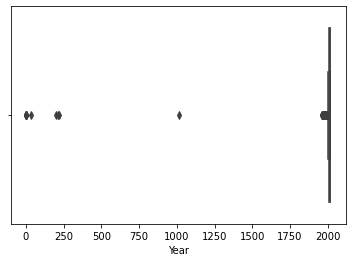

In [21]:
ax = sns.boxplot(x=hch['Year'])

In [22]:
hch.loc[hch['Year']<1900,'Year'] = np.nan

**Causes field is has entry typo with *Hiperglumia* and needs space trimming**

[Text(0, 0, 'HIPERGLUCEMIA'),
 Text(1, 0, 'HIPERTENSION'),
 Text(2, 0, 'HIPOGLUCEMIA'),
 Text(3, 0, 'PANCREATITIS'),
 Text(4, 0, 'COMA DIABETICO'),
 Text(5, 0, 'CRISIS HIPERTENSIVA'),
 Text(6, 0, 'NEUMONIA'),
 Text(7, 0, 'HIPOTIROIDISMO'),
 Text(8, 0, 'HISTERECTOMIA'),
 Text(9, 0, 'EMBOLIA')]

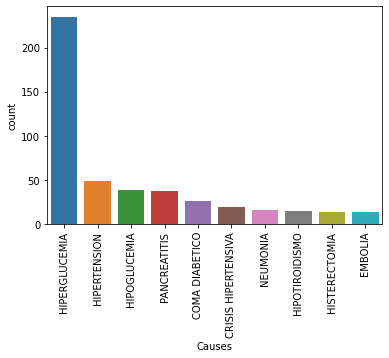

In [23]:
hch['Causes'] = hch['Causes'].str.strip()
hch.loc[hch['Causes']=='HIPERGLICEMIA','Causes'] = 'HIPERGLUCEMIA'
ax = sns.countplot(x='Causes', data=hch, order=pd.value_counts(hch['Causes']).iloc[:10].index)
ax.set_xticklabels(ax.get_xticklabels(),rotation = 90)

**60% patients are hospitalized for less than 4 days.**

<AxesSubplot:xlabel='Days', ylabel='Count'>

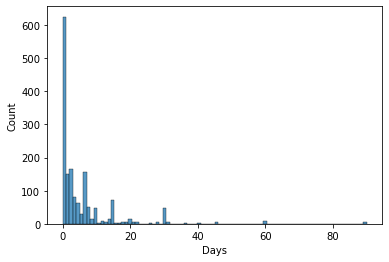

In [24]:
sns.histplot(data=hch, x='Days')

<AxesSubplot:xlabel='Days', ylabel='Count'>

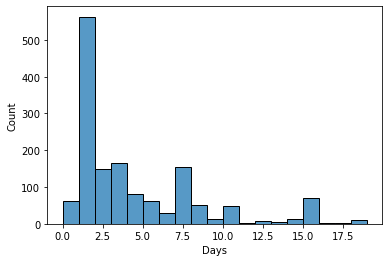

In [25]:
sns.histplot(data=hch[hch['Days']<20], x='Days')

#### historialcitascanceladas - capp: Cancelled appointments

In [26]:
capp.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7162 entries, 0 to 7161
Data columns (total 13 columns):
 #   Column                     Non-Null Count  Dtype         
---  ------                     --------------  -----         
 0   Cancelled Appointments ID  7162 non-null   int64         
 1   Agenda ID                  7162 non-null   int64         
 2   Patient ID                 7147 non-null   float64       
 3   Available areas            7162 non-null   object        
 4   Create Date                7162 non-null   datetime64[ns]
 5   Create Time                7162 non-null   object        
 6   High Date                  7162 non-null   datetime64[ns]
 7   Attendance                 407 non-null    object        
 8   Reason                     6222 non-null   object        
 9   Branch id                  7162 non-null   int64         
 10  Confirmacion               1175 non-null   object        
 11  Appointment Status         7162 non-null   object        
 12  Cancel

* ID parameteres are int64 type which needs to be changed to object.
* Patient IDs are incomplete 8.3%.
* Attendance is missing 94.3% data.

In [27]:
capp = capp.astype({'Patient ID':'object', 'Agenda ID':'object', 'Cancelled Appointments ID':'object', 'Branch id':'object'})
capp.describe(include='object', datetime_is_numeric=True)

,Cancelled Appointments ID,Agenda ID,Patient ID,Available areas,Create Time,Attendance,Reason,Branch id,Confirmacion,Appointment Status
count,7162,7162,7147.0,7162,7162,407,6222,7162,1175,7162
unique,7162,7021,3686.0,7,37,4,10,7,3,1
top,1,2383862,0.0,NUTRICIÓN,10:00:00,ASISTIO,CONSULTA NUTRICION,1,CONFIRMO,AGENDADA
freq,1,3,618.0,2264,879,356,1988,1853,796,7162


In [28]:
#94.3% missing in Attendance and 83.6% missing in Confirmacion. Appointment status has only 1 value
capp = capp.drop({'Attendance','Confirmacion','Appointment Status'},1)

[Text(0, 0, 'NUTRICIÓN'),
 Text(1, 0, 'TODOS'),
 Text(2, 0, 'EXPRESS O MONITOREO'),
 Text(3, 0, 'PSICOLOGÍA'),
 Text(4, 0, 'CONTROL VITAL'),
 Text(5, 0, 'EXPRESS'),
 Text(6, 0, 'PODOLOGIA')]

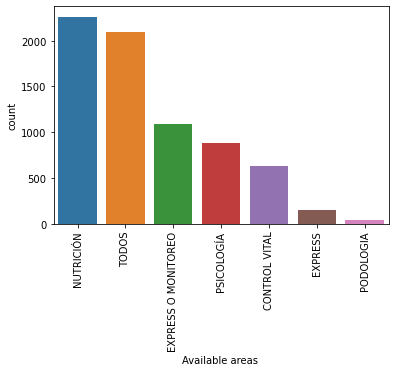

In [29]:
ax = sns.countplot(x="Available areas ",data=capp, order=pd.value_counts(capp['Available areas ']).iloc[:10].index)
ax.set_xticklabels(ax.get_xticklabels(),rotation = 90)

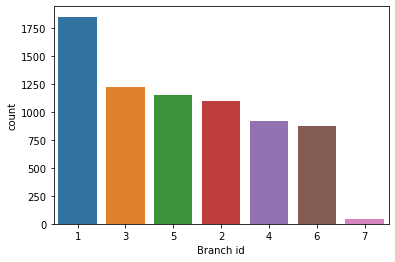

In [30]:
ax = sns.countplot(x="Branch id",data=capp, order=pd.value_counts(capp['Branch id']).iloc[:10].index)

#### historialcitasagendadas - sapp: Scheduled appointments

In [31]:
sapp.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10883 entries, 0 to 10882
Data columns (total 9 columns):
 #   Column              Non-Null Count  Dtype         
---  ------              --------------  -----         
 0   Create Time         10883 non-null  object        
 1   Create Date         10883 non-null  datetime64[ns]
 2   High Date           10883 non-null  datetime64[ns]
 3   Attendance          145 non-null    object        
 4   Reason              10071 non-null  object        
 5   Branch id           10883 non-null  int64         
 6   Appointment Status  10883 non-null  object        
 7   Change Date         10883 non-null  datetime64[ns]
 8   FechaAgenda         0 non-null      float64       
dtypes: datetime64[ns](3), float64(1), int64(1), object(4)
memory usage: 765.3+ KB


In [32]:
sapp = sapp.astype({'Branch id':'object'})
sapp.describe(include='object', datetime_is_numeric=True)

,Create Time,Attendance,Reason,Branch id,Appointment Status
count,10883,145,10071,10883,10883
unique,37,4,10,7,2
top,10:00:00,ASISTIO,CONSULTA NUTRICION,1,AGENDADA
freq,1271,91,2609,3728,10882


In [33]:
sapp = sapp.drop({'FechaAgenda','Attendance'},1)

#### pacientes - patient: Patient profile

In [34]:
patient.head(3)

,Patient ID,YearBirth,Branch id,Town,State,Sex,Marital status,Religion,Ocupacion,Scholarship,Create Date,Create Time,IdInteresado,ProgramaRecomendados,Social Security,RecordarCita,EstadioValor,Estadio
0,1,1928.0,1,GUADALUPE,NUEVO LEÓN,H,SOLTERÍA,CATOLICA,ALBAÑIL,NINGUNA,2013-02-19,13:55:23,16432,0,imss,1,NaN,NaN
1,2,1971.0,1,GUADALUPE,NUEVO LEÓN,H,MATRIMONIO,NaN,INSTALACION MECANICA,LEER Y ESCRIBIR,2013-02-19,13:55:23,16433,0,IMSS,1,NaN,NaN
2,3,1943.0,1,GUADALUPE,NUEVO LEÓN,M,MATRIMONIO,CATOLICA,HOGAR,PREPARATORIA,2013-02-19,13:55:23,16434,0,IMSS,1,8.8,5.0


In [35]:
patient.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 14855 entries, 0 to 14854
Data columns (total 18 columns):
 #   Column                Non-Null Count  Dtype         
---  ------                --------------  -----         
 0   Patient ID            14855 non-null  int64         
 1   YearBirth             14813 non-null  float64       
 2   Branch id             14855 non-null  int64         
 3   Town                  14807 non-null  object        
 4   State                 14812 non-null  object        
 5   Sex                   14714 non-null  object        
 6   Marital status        14648 non-null  object        
 7   Religion              5186 non-null   object        
 8   Ocupacion             14236 non-null  object        
 9   Scholarship           5076 non-null   object        
 10  Create Date           14855 non-null  datetime64[ns]
 11  Create Time           14855 non-null  object        
 12  IdInteresado          14855 non-null  int64         
 13  ProgramaRecomend

In [36]:
patient = patient.astype({'Patient ID':'object', 'Branch id':'object', 'ProgramaRecomendados':'object', 'IdInteresado':'object'})
patient.describe(include='all')

<ipython-input-36-80d7bea91bb2>:2: FutureWarning:

Treating datetime data as categorical rather than numeric in `.describe` is deprecated and will be removed in a future version of pandas. Specify `datetime_is_numeric=True` to silence this warning and adopt the future behavior now.



,Patient ID,YearBirth,Branch id,Town,State,Sex,Marital status,Religion,Ocupacion,Scholarship,Create Date,Create Time,IdInteresado,ProgramaRecomendados,Social Security,RecordarCita,EstadioValor,Estadio
count,14855.0,14813.000000,14855.0,14807,14812,14714,14648,5186,14236,5076,14855,14855,14855.0,14855.0,14488,14855.000000,3701.000000,3701.000000
unique,14855.0,NaN,7.0,227,19,2,5,138,234,8,1124,11631,14855.0,2.0,72,NaN,NaN,NaN
top,1.0,NaN,1.0,MONTERREY,NUEVO LEÓN,M,MATRIMONIO,CATOLICA,EMPLEADO,PREPARATORIA,2013-02-19 00:00:00,13:55:23,32768.0,0.0,IMSS,NaN,NaN,NaN
freq,1.0,NaN,6215.0,3148,14713,8278,10492,2809,5196,1313,817,770,1.0,13039.0,8954,NaN,NaN,NaN
first,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2013-02-19 00:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN
last,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2016-12-30 00:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN
mean,NaN,1962.313576,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.998452,97.153148,1.366928
std,NaN,12.855983,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.039319,27.069176,0.833052
min,NaN,1900.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,0.000000,0.000000
25%,NaN,1954.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.000000,89.300000,1.000000


  0%|                                                                                         | 0/1726 [00:00<…

DataPrep Report
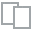
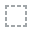
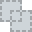
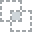
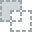
...
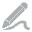
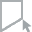
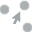
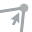
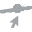

In [39]:
create_report(patient)

In [38]:
#agenda.describe()

## Derive subsets of the outcome variables

*   Skips appointment 
*	Cancels appointment
*	Reschedules appointment

In [40]:
capp.head(3)

,Cancelled Appointments ID,Agenda ID,Patient ID,Available areas,Create Date,Create Time,High Date,Reason,Branch id,Cancellation Date
0,1,94770,6979.0,NUTRICIÓN,2015-09-03,10:30:00,2014-10-27,NaN,3,2015-09-02 15:01:46
1,2,166130,3385.0,CONTROL VITAL,2015-10-02,09:00:00,2015-09-02,NaN,3,2015-09-02 15:06:21
2,3,166132,3385.0,NUTRICIÓN,2015-10-02,09:00:00,2015-09-02,NaN,3,2015-09-02 15:06:37


Using cancelled appointments table for getting skipped appointment and cancelled appointments
* if cancellation date/time is before appointment date/time, then classify that row as "cancelled appointment"
* if cancellation date/time is after appointment date/time, then classify that row as "skipped appointment".
    Assuming that appointment gets automatically cancelled if the patient skips appointment.


In [157]:
#CLASSIFYING CANCELLATION ROW ITEMS AS SKIP OR CANCELLED APPOINTMENTS

capp['cancellation time'] = pd.DatetimeIndex(capp['Cancellation Date']).time
capp['cancellation day'] = pd.DatetimeIndex(capp['Cancellation Date']).date

capp['cancel?'] = np.nan
capp.loc[(capp['cancellation day']<capp['Create Date']),'cancel?']='cancel'
capp.loc[pd.isna(capp['cancel?']),'cancel?']='pot skip'

capp['skip?'] = np.nan
capp.loc[(capp['cancellation time']>capp['Create Time']),'skip?']='skip'

capp['skip/cancel'] = 'cancel'
capp.loc[(capp['cancel?']=='pot skip') & (capp['skip?']=='skip'),'skip/cancel'] = 'skip'
capp.loc[pd.isna(capp['skip/cancel']),'skip/cancel'] = 'cancel'

capp = capp.drop({'skip?','cancel?'},1)

#==============================================================
#CREATING CANCELS APPOINTMENT DATAFRAME FROM ABOVE CLASSICATION

cancel = capp[['Patient ID','Available areas ', 
               'Create Date', 'Create Time', 'High Date', 'Reason',
               'Branch id', 'Cancelled Appointments ID', 'Cancellation Date', 'skip/cancel']]

cancel = cancel[cancel['skip/cancel']=='cancel']
cancel = cancel.drop({'skip/cancel'},1)

cancel.columns = ['Patient ID', 'Areas ', 'Appointment Date', 
                  'Appointment Time', 'Date Added', 'Reason',
                  'Branch id','Cancelled ID', 'Cancellation Date']


#==============================================================
#CREATING SKIPS APPOINTMENT DATAFRAME FROM ABOVE CLASSICATION

skips = capp[['Patient ID','Available areas ', 
               'Create Date', 'Create Time', 'High Date', 'Reason',
               'Branch id', 'Cancelled Appointments ID', 'Cancellation Date', 'skip/cancel']]

skips = skips[skips['skip/cancel']=='skip']
skips = skips.drop({'skip/cancel'},1)

skips.columns = ['Patient ID', 'Areas ', 'Appointment Date', 
                  'Appointment Time', 'Date Added', 'Reason',
                  'Branch id','Cancelled ID', 'Cancellation Date']


In [149]:
cancel.head(10)

,Patient ID,Areas,Appointment Date,Appointment Time,Date Added,Reason,Branch id,Cancelled ID,Cancellation Date
0,6979.0,NUTRICIÓN,2015-09-03,10:30:00,2014-10-27,NaN,3,1,2015-09-02 15:01:46
1,3385.0,CONTROL VITAL,2015-10-02,09:00:00,2015-09-02,NaN,3,2,2015-09-02 15:06:21
2,3385.0,NUTRICIÓN,2015-10-02,09:00:00,2015-09-02,NaN,3,3,2015-09-02 15:06:37
3,4966.0,NUTRICIÓN,2015-10-07,15:00:00,2015-09-02,CONSULTA NUTRICION,1,4,2015-09-02 18:45:21
4,6303.0,CONTROL VITAL,2015-10-01,12:00:00,2015-09-02,NaN,1,6,2015-09-03 09:01:47
5,6303.0,NUTRICIÓN,2015-10-01,12:00:00,2015-09-02,NaN,1,7,2015-09-03 09:01:58
6,6438.0,CONTROL VITAL,2015-09-03,11:30:00,2014-10-10,CONSULTA PSICOLOGIA,1,8,2015-09-03 09:43:44
7,6639.0,NUTRICIÓN,2015-09-08,09:00:00,2015-09-02,NaN,1,9,2015-09-03 10:16:35
8,6332.0,CONTROL VITAL,2015-10-02,08:30:00,2015-09-02,CONSULTA NUTRICION,4,10,2015-09-03 10:56:53
9,6865.0,PSICOLOGÍA,2015-09-08,14:15:00,2014-10-10,MONITOREO,1,11,2015-09-03 12:24:24


In [153]:
cancel.describe(include='all', datetime_is_numeric=True)

,Patient ID,Areas,Appointment Date,Appointment Time,Date Added,Reason,Branch id,Cancelled ID,Cancellation Date
count,6622.0,6636,6636,6636,6636,5764,6636.0,6636.0,6636
unique,3516.0,7,NaN,35,NaN,10,7.0,6636.0,NaN
top,0.0,NUTRICIÓN,NaN,10:00:00,NaN,CONSULTA NUTRICION,1.0,1.0,NaN
freq,554.0,2101,NaN,827,NaN,1851,1739.0,1.0,NaN
mean,NaN,NaN,2016-06-08 02:20:10.849909760,NaN,2016-02-28 15:06:11.066907904,NaN,NaN,NaN,2016-05-27 02:34:49.016576
min,NaN,NaN,2015-09-03 00:00:00,NaN,2014-10-10 00:00:00,NaN,NaN,NaN,2015-09-02 15:01:46
25%,NaN,NaN,2016-02-26 00:00:00,NaN,2015-10-30 00:00:00,NaN,NaN,NaN,2016-02-16 04:50:47.750000128
50%,NaN,NaN,2016-06-21 00:00:00,NaN,2016-04-11 00:00:00,NaN,NaN,NaN,2016-06-06 13:44:44.500000
75%,NaN,NaN,2016-09-28 00:00:00,NaN,2016-06-01 00:00:00,NaN,NaN,NaN,2016-09-13 12:21:20.500000
max,NaN,NaN,2016-12-31 00:00:00,NaN,2016-12-21 00:00:00,NaN,NaN,NaN,2016-12-30 15:01:00


In [154]:
cancel.to_csv('CancelsAppointment.csv')

In [150]:
skips.head(10)

,Patient ID,Areas,Appointment Date,Appointment Time,Date Added,Reason,Branch id,Cancelled ID,Cancellation Date
31,7299.0,TODOS,2015-09-07,17:00:00,2015-09-02,NaN,2,33,2015-09-07 17:14:20
36,5082.0,NUTRICIÓN,2015-09-08,10:45:00,2015-06-02,CONSULTA PSICOLOGIA,2,38,2015-09-08 11:22:59
39,5066.0,CONTROL VITAL,2015-09-08,13:00:00,2015-09-02,NaN,1,41,2015-09-08 13:06:53
40,6596.0,CONTROL VITAL,2015-09-08,15:00:00,2015-09-02,MONITOREO,3,42,2015-09-08 16:50:00
43,5001.0,CONTROL VITAL,2015-09-09,09:00:00,2015-09-02,2DO. SEG. 6 MESES,2,45,2015-09-09 09:21:54
62,3139.0,NUTRICIÓN,2015-09-11,15:00:00,2015-09-02,NaN,1,64,2015-09-11 16:37:53
107,952.0,TODOS,2015-09-18,11:00:00,2015-09-02,NaN,1,109,2015-09-18 11:14:29
134,6216.0,TODOS,2015-09-22,11:00:00,2015-09-02,1ER. SEG. 3 MESES,5,136,2015-09-22 11:05:03
135,5381.0,CONTROL VITAL,2015-09-22,11:00:00,2015-09-02,MONITOREO,1,137,2015-09-22 11:07:43
136,5381.0,NUTRICIÓN,2015-09-22,11:00:00,2015-09-02,NaN,1,138,2015-09-22 11:07:50


In [155]:
skips.describe(include='all', datetime_is_numeric=True)

,Patient ID,Areas,Appointment Date,Appointment Time,Date Added,Reason,Branch id,Cancelled ID,Cancellation Date
count,525.0,526,526,526,526,458,526.0,526.0,526
unique,407.0,7,NaN,24,NaN,10,7.0,526.0,NaN
top,0.0,NUTRICIÓN,NaN,08:00:00,NaN,CONSULTA NUTRICION,1.0,4096.0,NaN
freq,64.0,163,NaN,77,NaN,137,114.0,1.0,NaN
mean,NaN,NaN,2016-06-26 04:20:04.562737408,NaN,2016-03-29 07:28:58.403041792,NaN,NaN,NaN,2016-06-26 17:15:43.844106496
min,NaN,NaN,2015-09-07 00:00:00,NaN,2015-06-02 00:00:00,NaN,NaN,NaN,2015-09-07 17:14:20
25%,NaN,NaN,2016-03-24 06:00:00,NaN,2015-11-30 12:00:00,NaN,NaN,NaN,2016-03-24 19:32:11.249999872
50%,NaN,NaN,2016-07-29 00:00:00,NaN,2016-04-30 00:00:00,NaN,NaN,NaN,2016-07-29 13:16:53.500000
75%,NaN,NaN,2016-10-18 00:00:00,NaN,2016-06-24 06:00:00,NaN,NaN,NaN,2016-10-18 16:26:32.750000128
max,NaN,NaN,2016-12-30 00:00:00,NaN,2016-12-02 00:00:00,NaN,NaN,NaN,2016-12-30 11:28:45


In [156]:
skips.to_csv('SkipsAppointment.csv')

## Derive a subset of the engagement predictor variables


*    Demographics. For example, marital status could be derived from EstadoCivil
*    Geography. For example, distance from clinic is dependent on city and state which are in Ciudad and Estado respectively
